<a href="https://colab.research.google.com/github/ag2816/BuildingStyleClassifier/blob/master/BuildingStyleClassifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from fastai.vision import *

In [4]:
!pip install PyDrive

In [0]:
import zipfile, os
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

Create data folder where can upload images of different building styles

In [0]:
path = Path('data/buildings')
folders=['Art deco','Arts and Crafts', 'Georgian revival']
for folder in folders:
  dest = path/folder
  dest.mkdir(parents=True, exist_ok=True)

Get zip file of images from google drive

In [0]:
file_ids=['1iEjKWx6fWDpR-tDCevf4vRDjvTgRUWS7','1JwB6wsosdLDFfYv-2ji4rvHtTx4kiude','1Xi9dOIiL89TQ80Zz7w1Mt5kUeylT31Yz']
file_names=['Art deco.zip','Arts and Crafts.zip', 'Georgian revival.zip']
i=0
for filename in file_names:
  #i in range(len(folders)):
  #https://drive.google.com/open?id=1iEjKWx6fWDpR-tDCevf4vRDjvTgRUWS7
  download = drive.CreateFile({'id': file_ids[i]})
  myfile=download.GetContentFile(filename)
  i+=1

In [9]:
# UNZIP ZIP
i=0
for filename in file_names:
  print ("Uncompressing zip file")
  zip_ref = zipfile.ZipFile(filename, 'r')
  # Art dec is a folder
 # zip_ref.extractall(f'data/buildings/{folders[i]}/')
  zip_ref.extractall(f'data/buildings/')
  i+=1
  zip_ref.close()


Uncompressing zip file
Uncompressing zip file
Uncompressing zip file


In [0]:
# filename='Georgian revival.zip'
# print ("Uncompressing zip file")
# zip_ref = zipfile.ZipFile(filename, 'r')
# # Art dec is a folder
# zip_ref.extractall(f'data/buildings/Georgian revival/')
# i+=1
# zip_ref.close()

In [0]:
# filename='Arts and Crafts.zip'
# print ("Uncompressing zip file")
# zip_ref = zipfile.ZipFile(filename, 'r')
# # Art dec is a folder
# zip_ref.extractall(f'data/buildings/Arts and Crafts/')
# i+=1
# zip_ref.close()

In [0]:
# filename='Art deco.zip'
# print ("Uncompressing zip file")
# zip_ref = zipfile.ZipFile(filename, 'r')
# # Art dec is a folder
# zip_ref.extractall(f'data/buildings/')
# i+=1
# zip_ref.close()

In [0]:
path='data/buildings'
path = Path(path)

View data

In [0]:
np.random.seed(42)
data = ImageDataBunch.from_folder(path, train=".", valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4).normalize(imagenet_stats)

In [15]:
data.classes

['Art deco', 'Arts and Crafts', 'Georgian revival']

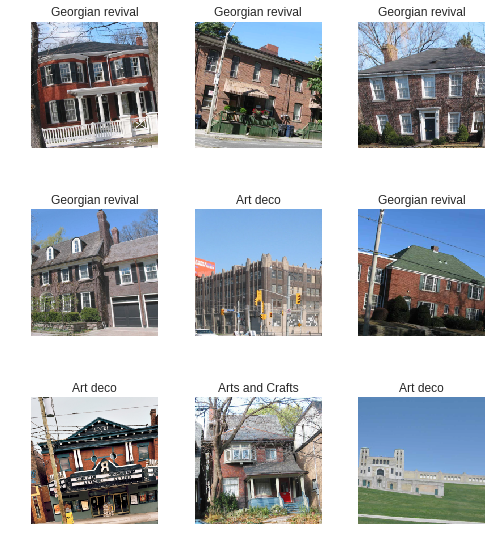

In [16]:
data.show_batch(rows=3, figsize=(7,8))


In [17]:
data.classes, data.c, len(data.train_ds), len(data.valid_ds)

(['Art deco', 'Arts and Crafts', 'Georgian revival'], 3, 272, 67)

Train model

In [0]:
learn = create_cnn(data, models.resnet34, metrics=error_rate)

In [19]:
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate
1,1.448956,1.146568,0.552239
2,1.137101,0.679279,0.313433
3,0.913033,0.623772,0.268657
4,0.792703,0.622997,0.298507


In [0]:
learn.save('stage-1')

In [0]:
learn.unfreeze()

In [22]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


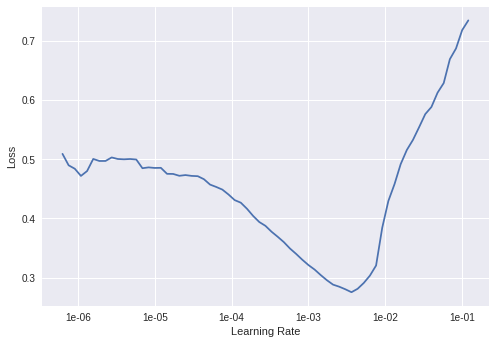

In [23]:
learn.recorder.plot()

In [0]:
#.00003
#1e-05 .00001

NOtes: if validation_loss is really high, your learning rate is too high
* if LR too low, learns very very slowly.  also training loss will be > validation loss
* too few epochs: validation loss is much higher than training loss

Learning rate -- first pass defaults to 3e-3 (.003); want to try next pass at about 10X higher

In [25]:
learn.fit_one_cycle(2, max_lr=slice(3e-5,3e-4))

epoch,train_loss,valid_loss,error_rate
1,0.473072,0.664652,0.313433
2,0.403692,0.706301,0.283582


In [26]:
learn.fit_one_cycle(2, max_lr=slice(1e-05,3e-4))

epoch,train_loss,valid_loss,error_rate
1,0.229021,0.705962,0.253731
2,0.248066,0.674317,0.268657


In [0]:
learn.save('stage-2')

In [0]:
learn.load('stage-2');

In [0]:
interp = ClassificationInterpretation.from_learner(learn)

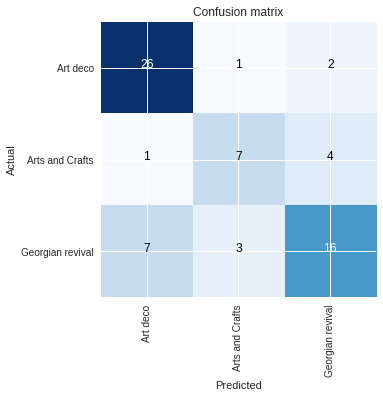

In [30]:
interp.plot_confusion_matrix()

Plot top losses

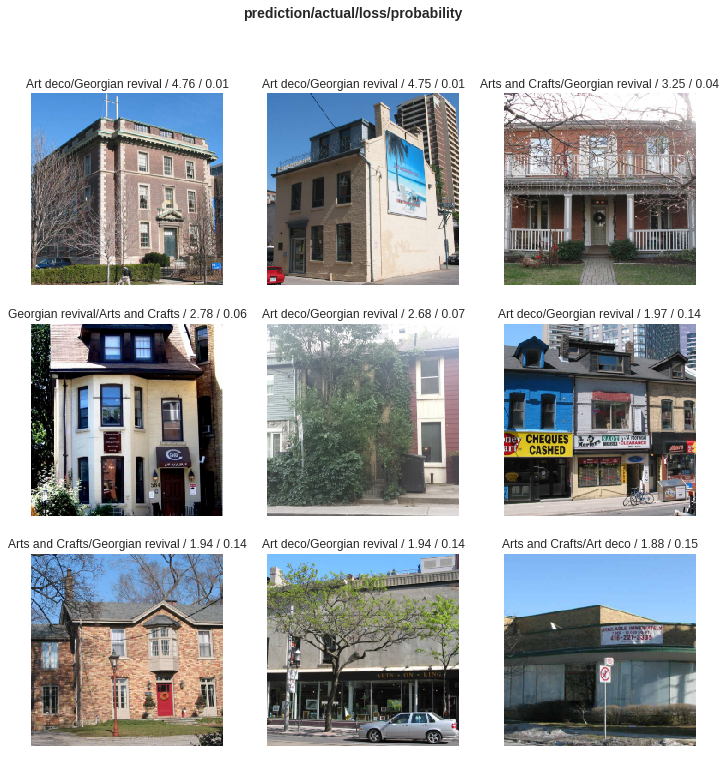

In [40]:
interp.plot_top_losses(9)

In [41]:

interp.most_confused()

[('Georgian revival', 'Art deco', 7),
 ('Arts and Crafts', 'Georgian revival', 4),
 ('Georgian revival', 'Arts and Crafts', 3),
 ('Art deco', 'Georgian revival', 2)]

In [42]:

data.c

3

Clean up

In [0]:
from fastai.widgets import *

Find our top losses and perhaps remove photos that do not belong

In [0]:
ds, idxs = DatasetFormatter().from_toplosses(learn, ds_type=DatasetType.Valid)

In [0]:
#ImageCleaner(ds, idxs, path)

NameError: ignored

Find and remove duplicates

In [0]:
ds, idxs = DatasetFormatter().from_similars(learn, ds_type=DatasetType.Valid)

In [0]:
ImageCleaner(ds, idxs, path, duplicates=True)

Move to production

In [0]:
learn.export()

In [0]:
defaults.device = torch.device('cpu')

* get a sample image of an Art Deco building our model has not seen to predict
* Image is By Tony Hisgett from Birmingham, UK - Chrysler Building 1Uploaded by Magnus Manske, CC BY 2.0, https://commons.wikimedia.org/w/index.php?curid=21107852

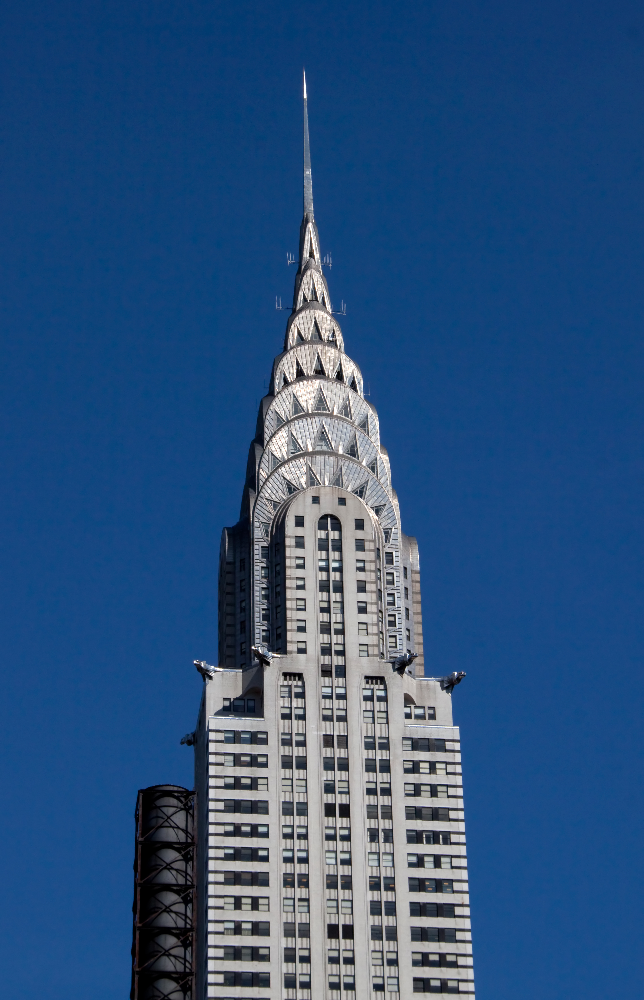

In [50]:
img = open_image('/content/Chrysler_Building_1_(4684845155).jpg')
img

Load our pickled model and then our sample image (which is correctly classfied as an art deco image)

In [0]:
learn = load_learner(path)

In [52]:
pred_class,pred_idx,outputs = learn.predict(img)
pred_class

Category Art deco

In [0]:
#accuracy??